# Importing Libraries

In [273]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import BayesianRidge
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_squared_error, r2_score

# Data Preprocessing and Cleaning

In [3]:
df_sub = pd.read_csv("subscriptions_merged.csv") #merged file between original subscriptions_mix and the new subscriptions_60K
trans_df = pd.read_csv("new_transactions.csv") #transactional dataset from lumoshive

C:\Users\Felix Ferdinad\AppData\Local\Temp\ipykernel_12936\1169167114.py:1: DtypeWarning: Columns (5,7,11,14,17,21,23,24) have mixed types. Specify dtype option on import or set low_memory=False.
  df_sub = pd.read_csv("subscriptions_merged.csv") #merged file between original subscriptions_mix and the new subscriptions_60K
C:\Users\Felix Ferdinad\AppData\Local\Temp\ipykernel_12936\1169167114.py:2: DtypeWarning: Columns (4,6,14,15,16,19,20) have mixed types. Specify dtype option on import or set low_memory=False.
  trans_df = pd.read_csv("new_transactions.csv") #transactional dataset from lumoshive


In [4]:
print(df_sub.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 365614 entries, 0 to 365613
Data columns (total 27 columns):
 #   Column             Non-Null Count   Dtype 
---  ------             --------------   ----- 
 0   Unnamed: 0         365614 non-null  int64 
 1   id                 365614 non-null  int64 
 2   created_at         365614 non-null  object
 3   country            365614 non-null  object
 4   operator           365614 non-null  object
 5   service            365614 non-null  object
 6   source             354366 non-null  object
 7   msisdn             365614 non-null  object
 8   status             365614 non-null  int64 
 9   cycle              365613 non-null  object
 10  adnet              177233 non-null  object
 11  revenue            365614 non-null  object
 12  subs_date          365614 non-null  object
 13  renewal_date       365581 non-null  object
 14  freemium_end_date  221176 non-null  object
 15  unsubs_from        88987 non-null   object
 16  unsubs_date        1

In [5]:
drop = [  
    "id",   
    "created_at",
    "pixel",     
    "browser",
    "handset",
    "msisdn",
    "service",
    "trxid",
    "publisher" 
]

check = ((df_sub['success_billing'] > df_sub['attempt_charging']) | (df_sub['subs_date'] > df_sub['unsubs_date'])) 

df_sub.drop(df_sub.index[2], inplace=True) 
df_sub.drop(columns = drop, inplace=True) 
df_sub.drop(check[check].index, inplace=True) 

df_sub


,Unnamed: 0,country,operator,source,status,cycle,adnet,revenue,subs_date,renewal_date,freemium_end_date,unsubs_from,unsubs_date,service_price,currency,profile_status,attempt_charging,success_billing
0,0,TH,ais,sms,0,daily,NaN,0,2022-10-20 19:28:02.000,2023-09-14 00:00:00.000,2022-10-20 00:00:00.000,NaN,NaN,6,BATH,Active,15,0
1,1,TH,ais,sms,0,daily,NaN,0,2020-08-23 16:11:02.000,2023-09-14 00:00:00.000,2020-08-23 00:00:00.000,NaN,NaN,6,BATH,Active,15,0
3,3,TH,ais,wap,0,daily,star,0,2023-09-09 13:03:24.000,2023-09-14 00:00:00.000,2023-09-09 00:00:00.000,NaN,NaN,6,BATH,Active,5,0
4,4,TH,ais,sms,0,daily,NaN,0,2022-09-26 19:36:03.000,2023-09-14 00:00:00.000,2022-09-26 00:00:00.000,NaN,NaN,6,BATH,Active,15,0
5,5,TH,ais,sms,0,daily,NaN,0,2021-08-06 16:27:07.000,2023-09-14 00:00:00.000,2021-08-06 00:00:00.000,NaN,NaN,6,BATH,Active,15,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
365609,56698,TH,ais,sms,0,daily,NaN,0,20:10.0,00:00.0,00:00.0,NaN,NaN,6,BATH,Active,0,0
365610,56699,TH,ais,wap,1,daily,mpl,0,07:04.0,00:00.0,00:00.0,NaN,NaN,6,BATH,Active,35,0
365611,56700,TH,aisgemezz,SMS,1,daily,BTM,0,37:27.0,00:00.0,00:00.0,NaN,NaN,0,BAHT,Active,112,14
365612,56701,TH,ais,sms,0,daily,NaN,0,20:04.0,00:00.0,00:00.0,NaN,NaN,6,BATH,Active,0,0


In [6]:
df_sub.isna().sum()

Unnamed: 0                0
country                   0
operator                  0
source                10283
status                    0
cycle                     1
adnet                185061
revenue                   0
subs_date                 0
renewal_date             33
freemium_end_date     75724
unsubs_from          242907
unsubs_date          223512
service_price             0
currency              17473
profile_status        33026
attempt_charging          0
success_billing           0
dtype: int64

In [7]:
df_sub.dropna(subset=['country', 'operator', 'status', 'cycle', 'revenue', 'subs_date', 'renewal_date', 'service_price', 'attempt_charging', 'success_billing'], inplace=True)
df_sub.isna().sum()

Unnamed: 0                0
country                   0
operator                  0
source                10250
status                    0
cycle                     0
adnet                185027
revenue                   0
subs_date                 0
renewal_date              0
freemium_end_date     75690
unsubs_from          242906
unsubs_date          223511
service_price             0
currency              17440
profile_status        32993
attempt_charging          0
success_billing           0
dtype: int64

In [8]:
print(df_sub['source'].unique())

for src in df_sub['source']:
    print(src)

['sms' 'wap' 'ivr' 'web' nan 'USSD' 'cp1' 'lp3' 'lp1' 'SMS' 'lp4'
 'mo_ussd' 'lp6' 'mo_sms' 'portal' 'USSD_W' 'USSD_D' 'WAP' 'default']
sms
sms
wap
sms
sms
sms
wap
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
wap
sms
wap
sms
sms
sms
sms
wap
sms
sms
wap
wap
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
wap
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
wap
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
wap
sms
sms
sms
wap
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
wap
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
wap
sms
sms
sms
sms
sms
sms
sms
sms
sms
wap
sms
sms
sms
sms
sms
sms
sms
sms
sms
wap
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
sms
wap
sms
sms
sms
wap
sms
sms
sms
sms
wap
sms
sms
sms
sms
sms
wap
sms
sms
sms
wap
sms
sms
sms
wap
sms
sms
sms
sms
sms
sms


In [9]:
df_sub['source'].value_counts()

source
sms        193183
cp1         50696
wap         20231
web          7190
SMS          3479
USSD         3053
lp3          3051
mo_ussd       853
USSD_D        174
USSD_W        133
portal         52
lp6            11
WAP            10
lp1             7
ivr             5
lp4             2
mo_sms          1
default         1
Name: count, dtype: int64

In [10]:
new_values = {'SMS' : 'sms', 
              'WAP' : 'wap'}
df_sub['source'].fillna(df_sub['source'].value_counts().index[3], inplace=True)
df_sub['source'].replace(new_values, inplace=True)


In [11]:
for every_currency in df_sub['currency']:
    print(every_currency)

BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH
BATH


In [12]:
print(df_sub['currency'].unique())
print(df_sub['country'].unique())

['BATH' nan 'LAK' 'Kip' 'Rial' 'IDR' 'PHP' 'BAHT']
['TH' 'SN' 'LA' 'OM' 'ID' 'PH']


In [13]:
correct_currency = {"BATH" : "BAHT", 
                    "Kip" : "LAK"}

df_sub['currency'].replace(correct_currency, inplace=True)

country_currency = {'TH': 'BAHT', 'SN': 'XOF', 'LA': 'LAK', 'OM': 'Rial', 'ID': 'IDR', 'PH': 'PHP'}
df_sub['currency'] = df_sub.apply(lambda row: country_currency.get(row['country'], row['currency']), axis=1)


In [14]:
df_sub.isna().sum()

Unnamed: 0                0
country                   0
operator                  0
source                    0
status                    0
cycle                     0
adnet                185027
revenue                   0
subs_date                 0
renewal_date              0
freemium_end_date     75690
unsubs_from          242906
unsubs_date          223511
service_price             0
currency                  0
profile_status        32993
attempt_charging          0
success_billing           0
dtype: int64

In [15]:
print("revenue = ", df_sub['revenue'].unique())
print("sv price = ", df_sub['service_price'].unique())

revenue =  [0 6 12 90 18 66 24 72 42 48 60 30 36 54 78 84 '0' '6' '18' '12' '24' '66'
 '30' '54' '150' '150:00:00' '0:00' '20000' '1000' '2000' '4000' '8000'
 '15000' '6000' '10000' '9000' '26000' '18000' '5000' '12000' '30000'
 '40000' '54000' '24000' '48000' '16000' '28000' '34000' '36000' '22000'
 '14000' '41000' '13000' '37000' '39000' '42000' '17000' '25000' '38000'
 '3000' '72000' '50000' '73000' '44000' '29000' '7000' '27000' '23000'
 '19000' '11000' '60000' '21000' '32000' '74000' '62000' '31000' '66000'
 '45000' '70000' '65000' '35000' '33000' '82000' '81000' '53000' '58000'
 '68000' '57000' '64000' '47000' '93000' '76000' '43000' '56000' '112000'
 '67000' '78000' '153000' '52000' '104000' '51000' '55000' '46000'
 '118000' '80000' '79000' '49000' '142000' '61000' '69000' '59000'
 '152000' '122000' '63000' '124000' '121000' '86000' '102000' '106000'
 '288000' '194000' '190000' '110000' '83000' '115000' '100000' '134000'
 '71000' '187000' '105000' '95000' '97000' '139000' '77000

In [16]:
date_to_int = {
    "150:00:00" : 150, #new values to convert this 'datelike' format into num
    "0:00"      : 0
}

price_changes = {
    '10000.00'   : 10000, 
    '2000:00:00' : 2000, 
    '1000:00:00' : 1000,
}

df_sub['revenue'] = df_sub['revenue'].replace(date_to_int) #replacing the datelike format to integer
df_sub['service_price'] = df_sub['service_price'].replace(price_changes)

In [17]:
df_sub['profile_status'].unique()


array(['Active', 'Unsub', nan, 'inactive', 'active', 'FALSE', 'Grace',
       'Purge'], dtype=object)

In [18]:
correct_profile = {
    "Active" : "active",
    "Unsub"  : "inactive",
    "FALSE"  :  None
}

df_sub['profile_status'] = df_sub['profile_status'].replace(correct_profile)

In [19]:
for i in df_sub['profile_status'].isna():
    print(i)

False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
False
Fals

In [20]:
df_sub['currency'].unique()

array(['BAHT', 'XOF', 'LAK', 'Rial', 'IDR', 'PHP'], dtype=object)

In [21]:
df_sub['attempt_charging'] = df_sub['attempt_charging'].astype(int) #assign dtypes for attribute that might be used later
df_sub['success_billing'] = df_sub['success_billing'].astype(int)
df_sub['service_price'] = df_sub['service_price'].astype(int)
df_sub['revenue'] = df_sub['revenue'].astype(int)
df_sub['status'] = df_sub['status'].astype(int)
df_sub['subs_date'] = pd.to_datetime(df_sub['subs_date'], errors='coerce')
df_sub['renewal_date'] = pd.to_datetime(df_sub['renewal_date'], errors='coerce')
df_sub['freemium_end_date'] = pd.to_datetime(df_sub['subs_date'], errors='coerce')
df_sub['unsubs_date'] = pd.to_datetime(df_sub['unsubs_date'], errors='coerce')

In [22]:
df_sub.dtypes

Unnamed: 0                    int64
country                      object
operator                     object
source                       object
status                        int32
cycle                        object
adnet                        object
revenue                       int32
subs_date            datetime64[ns]
renewal_date         datetime64[ns]
freemium_end_date    datetime64[ns]
unsubs_from                  object
unsubs_date          datetime64[ns]
service_price                 int32
currency                     object
profile_status               object
attempt_charging              int32
success_billing               int32
dtype: object

In [23]:
def ConvertToUSD(index: str):
    conversion_rate = {
               'BAHT' : 0.029,
               'LAK'  : 0.000049,
               'Rial' : 2.60,
               'XOF'  : 0.0017,
               'PHP'  : 0.018,
               'IDR'  : 0.000065}
    
    if index in conversion_rate:
        return conversion_rate[index]
    
df_sub['revenue_in_USD'] = df_sub['currency'].apply(ConvertToUSD) * df_sub['revenue']
df_sub['service_price_in_USD'] = df_sub['currency'].apply(ConvertToUSD) * df_sub['service_price']    

In [24]:
df_sub['monthly_subs'] = df_sub['subs_date'].dt.month
df_sub['yearly_subs'] = df_sub['subs_date'].dt.year
df_sub['hourly_subs'] = df_sub['subs_date'].dt.hour

df_sub['monthly_unsubs'] = df_sub['unsubs_date'].dt.month
df_sub['yearly_unsubs'] = df_sub['unsubs_date'].dt.year
df_sub['hourly_unsubs'] = df_sub['unsubs_date'].dt.hour

df_sub['monthly_renewal'] = df_sub['renewal_date'].dt.month
df_sub['hourly_renewal'] = df_sub['renewal_date'].dt.hour

df_sub['success_billing_rate'] = (df_sub['success_billing'] / df_sub['attempt_charging']) * 100
df_sub['failed_attempts_rate'] = 100 - df_sub['success_billing_rate']

In [25]:
df_sub['revenue_in_USD'].fillna(0, inplace=True)
df_sub['revenue_in_USD'] = df_sub['revenue_in_USD'].astype(int)
df_sub['service_price_in_USD'].fillna(0, inplace=True)
df_sub['service_price_in_USD'] = df_sub['service_price_in_USD'].astype(int)

In [26]:
print(df_sub.isna().sum())

Unnamed: 0                   0
country                      0
operator                     0
source                       0
status                       0
cycle                        0
adnet                   185027
revenue                      0
subs_date                41758
renewal_date             41925
freemium_end_date        41758
unsubs_from             242906
unsubs_date             246291
service_price                0
currency                     0
profile_status           32995
attempt_charging             0
success_billing              0
revenue_in_USD               0
service_price_in_USD         0
monthly_subs             41758
yearly_subs              41758
hourly_subs              41758
monthly_unsubs          246291
yearly_unsubs           246291
hourly_unsubs           246291
monthly_renewal          41925
hourly_renewal           41925
success_billing_rate     86565
failed_attempts_rate     86565
dtype: int64


In [27]:
columns_to_keep = ['country', 'operator', 'revenue_in_USD', 'cycle', 'status', 'failed_attempts_rate', 'success_billing_rate', 'yearly_subs', 'yearly_unsubs', 'success_billing', 'attempt_charging']

subscriptions_cleaned = df_sub[columns_to_keep].dropna()

In [28]:
subscriptions_cleaned

,country,operator,revenue_in_USD,cycle,status,failed_attempts_rate,success_billing_rate,yearly_subs,yearly_unsubs,success_billing,attempt_charging
1255,TH,ais,0,daily,1,100.000000,0.000000,2023.0,2023.0,0,2
1298,TH,ais,0,daily,1,90.909091,9.090909,2023.0,2023.0,1,11
1522,TH,ais,0,daily,1,100.000000,0.000000,2023.0,2023.0,0,3
2334,TH,ais,0,daily,0,100.000000,0.000000,2023.0,2023.0,0,1
2385,TH,ais,0,daily,1,100.000000,0.000000,2023.0,2023.0,0,2
...,...,...,...,...,...,...,...,...,...,...,...
308840,OM,omantel,780,daily,-1,0.000000,100.000000,2023.0,2023.0,1,1
308847,OM,omantel,0,daily,-1,100.000000,0.000000,2023.0,2023.0,0,1
308862,OM,omantel,780,daily,-1,0.000000,100.000000,2023.0,2023.0,1,1
308886,OM,omantel,780,daily,-1,0.000000,100.000000,2023.0,2023.0,1,1


# Transactional Data

In [29]:
print(trans_df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 510867 entries, 0 to 510866
Data columns (total 21 columns):
 #   Column              Non-Null Count   Dtype 
---  ------              --------------   ----- 
 0   id                  510867 non-null  int64 
 1   created_at          510867 non-null  object
 2   country             510867 non-null  object
 3   operator            510867 non-null  object
 4   service             510867 non-null  object
 5   source              480320 non-null  object
 6   msisdn              510867 non-null  object
 7   event               510867 non-null  object
 8   event_date          510867 non-null  object
 9   cycle               510867 non-null  object
 10  revenue             510867 non-null  int64 
 11  currency            480373 non-null  object
 12  charge_date         510867 non-null  object
 13  publisher           251899 non-null  object
 14  handset             178651 non-null  object
 15  browser             199576 non-null  object
 16  tr

In [30]:
trans_df.isna().sum()

id                         0
created_at                 0
country                    0
operator                   0
service                    0
source                 30547
msisdn                     0
event                      0
event_date                 0
cycle                      0
revenue                    0
currency               30494
charge_date                0
publisher             258968
handset               332216
browser               311291
trxid                 200700
telco_api_url          33919
telco_api_response     46996
sms_content           230590
status_sms            200084
dtype: int64

In [31]:
cols = {
    'browser', 
    'handset',  
    'sms_content', 
    'trxid', 
    'telco_api_response', 
    'msisdn',
    'publisher',
    'telco_api_url',
    'status_sms'
}

trans_df.drop(columns=cols, inplace=True)


In [32]:
print(trans_df['currency'].unique())
print(trans_df['country'].unique())

['IDR' nan 'LAK' 'Rial' 'Baisa' 'BATH' 'BAHT' 'PHP']
['ID' 'LA' 'OM' 'TH' 'PH' 'SN']


In [33]:
for i in trans_df['currency']:
    print(i)

IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
nan
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
nan
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
IDR
nan
IDR
IDR
IDR
IDR
IDR
IDR
IDR


In [34]:
correct_currency = {"BATH" : "BAHT"}

trans_df['currency'].replace(correct_currency, inplace=True)

country_currency = {'TH': 'BAHT', 'SN': 'XOF', 'LA': 'LAK', 'ID': 'IDR', 'PH': 'PHP'}
trans_df['currency'] = trans_df.apply(lambda row: country_currency.get(row['country'], row['currency']), axis=1)


In [35]:
trans_df.isna().sum()

id                 0
created_at         0
country            0
operator           0
service            0
source         30547
event              0
event_date         0
cycle              0
revenue            0
currency           0
charge_date        0
dtype: int64

In [36]:
trans_df['currency'].unique()

array(['IDR', 'LAK', 'Rial', 'Baisa', 'BAHT', 'PHP', 'XOF'], dtype=object)

In [37]:
trans_df['revenue_in_USD'] = trans_df['currency'].apply(ConvertToUSD) * trans_df['revenue']

In [38]:
trans_df['charge_date'] = pd.to_datetime(trans_df['charge_date'], errors='coerce')
trans_df['event_date'] = pd.to_datetime(trans_df['event_date'], errors='coerce')

In [39]:
trans_df['monthly_charge_date'] = trans_df['charge_date'].dt.month
trans_df['yearly_charge_date'] = trans_df['charge_date'].dt.year
trans_df['hourly_charge_date'] = trans_df['charge_date'].dt.hour

In [40]:
trans_df['event'].unique()

array(['RENEWAL', 'Retry Renewal', 'renewal', 'FIRSTPUSH', 'UNSUB',
       'Renewal', 'Subscription', 'Unsubscription', 'retry renewal',
       'subscribe@portal', 'subscribe-nb@cp1', 'renewal-nb@cp1', 'retry',
       'retry@mo_ussd', 'renewal@mo_ussd', 'renewal@charge',
       'charge-nb@cp1', 'renewal@cp1', 'retry@portal', 'subscribe-nb',
       'USSD_W@charge', 'USSD_D@charge', 'subscribe-nb@cp1_confirm',
       'retry@cp1', 'subscription', 'renewal-nb@cp1_confirm',
       'renewal@portal', 'retry@lp6', 'charge-nb', 'renewal@lp6',
       'renewal@mo_sms', 'subscribe', 'subscribe@lp1{${sleep(20)}}',
       'subscribe@(select*from(select(sleep(20)))a)',
       'subscribe@*)(!(objectClass=*)', 'subscribe@lp1',
       'subscribe@portal_confirm', 'retry@lp7', 'notif@renew', 'notif@mt',
       'unsubscribe', 'Trial'], dtype=object)

In [41]:
trans_df['source']

0         WAP
1         WAP
2         WAP
3         WAP
4         WAP
         ... 
510862    NaN
510863    NaN
510864    NaN
510865    NaN
510866    NaN
Name: source, Length: 510867, dtype: object

# Data Visualization

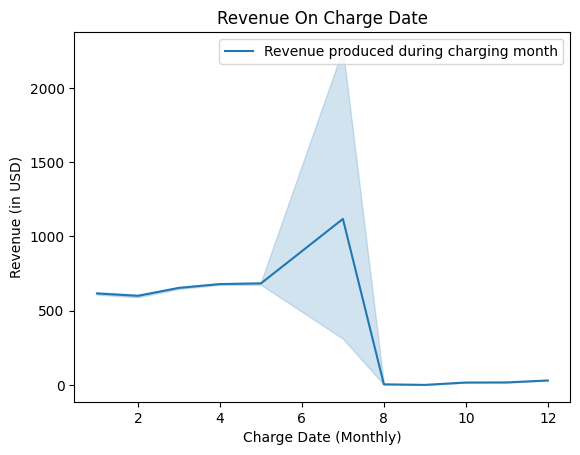

In [42]:
sns.lineplot(data= trans_df, x='monthly_charge_date', y='revenue_in_USD', label="Revenue produced during charging month")
plt.title("Revenue On Charge Date")
plt.xlabel("Charge Date (Monthly)")
plt.ylabel("Revenue (in USD)")
plt.show()

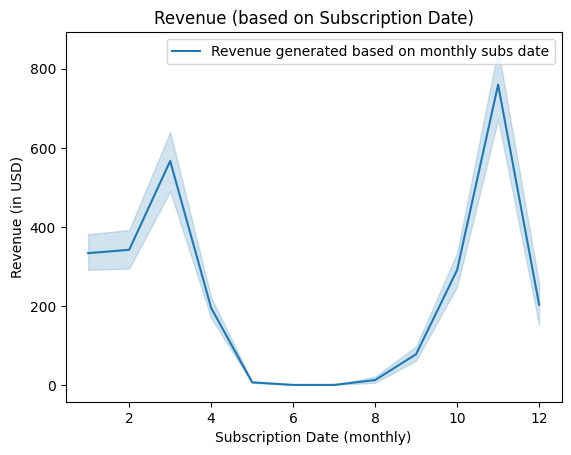

In [43]:
sns.lineplot(data= df_sub, x='monthly_subs', y='revenue_in_USD', label="Revenue generated based on monthly subs date")
plt.title("Revenue (based on Subscription Date)")
plt.xlabel("Subscription Date (monthly)")
plt.ylabel("Revenue (in USD)")
plt.show()

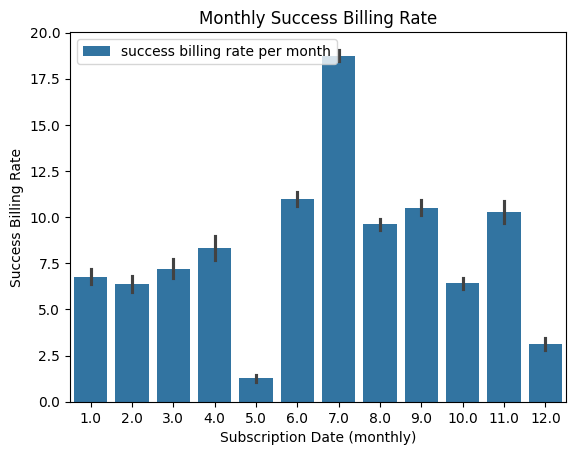

In [44]:
sns.barplot(data= df_sub, x='monthly_subs', y='success_billing_rate', label="success billing rate per month")
plt.title("Monthly Success Billing Rate")
plt.xlabel("Subscription Date (monthly)")
plt.ylabel("Success Billing Rate")
plt.show()


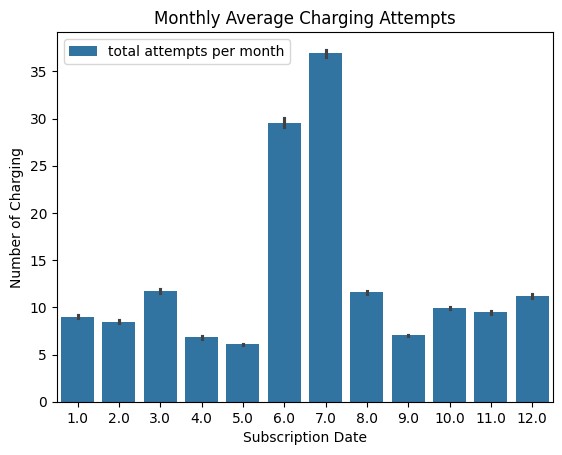

In [45]:
sns.barplot(data= df_sub, x='monthly_subs', y='attempt_charging', label="total attempts per month")
plt.title("Monthly Average Charging Attempts")
plt.xlabel("Subscription Date")
plt.ylabel("Number of Charging")
plt.show()

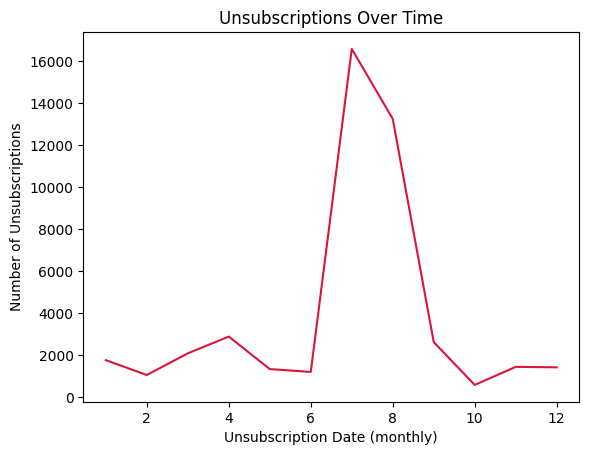

In [46]:
unsubs_by_month = df_sub.groupby('monthly_unsubs').size()
unsubs_by_month.plot(kind='line', color='crimson')
plt.title('Unsubscriptions Over Time')
plt.xlabel('Unsubscription Date (monthly)')
plt.ylabel('Number of Unsubscriptions')
plt.show()


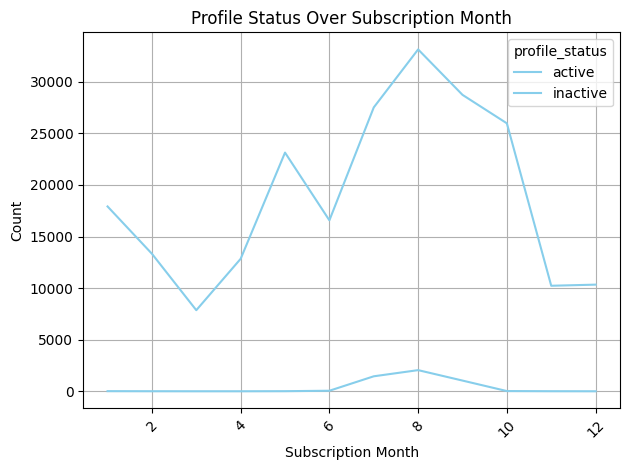

In [47]:
status_count = df_sub.groupby(['monthly_subs', 'profile_status']).size().unstack(fill_value=0)
status_count.plot(kind='line', color='skyblue')
plt.xlabel("Subscription Month")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.title("Profile Status Over Subscription Month")
plt.tight_layout()
plt.grid(True)
plt.show()

# Data Models

In [48]:
subscriptions_cleaned

,country,operator,revenue_in_USD,cycle,status,failed_attempts_rate,success_billing_rate,yearly_subs,yearly_unsubs,success_billing,attempt_charging
1255,TH,ais,0,daily,1,100.000000,0.000000,2023.0,2023.0,0,2
1298,TH,ais,0,daily,1,90.909091,9.090909,2023.0,2023.0,1,11
1522,TH,ais,0,daily,1,100.000000,0.000000,2023.0,2023.0,0,3
2334,TH,ais,0,daily,0,100.000000,0.000000,2023.0,2023.0,0,1
2385,TH,ais,0,daily,1,100.000000,0.000000,2023.0,2023.0,0,2
...,...,...,...,...,...,...,...,...,...,...,...
308840,OM,omantel,780,daily,-1,0.000000,100.000000,2023.0,2023.0,1,1
308847,OM,omantel,0,daily,-1,100.000000,0.000000,2023.0,2023.0,0,1
308862,OM,omantel,780,daily,-1,0.000000,100.000000,2023.0,2023.0,1,1
308886,OM,omantel,780,daily,-1,0.000000,100.000000,2023.0,2023.0,1,1


In [49]:
subscriptions_cleaned['yearly_subs'].unique()

array([2023., 2021., 2022.])

In [50]:
subscriptions_cleaned['country'].unique()

array(['TH', 'SN', 'LA', 'OM'], dtype=object)

In [51]:
# def categorize_time(hour):
#     if 4 <= hour <= 12:
#         return 'Morning'
#     elif 13 <= hour <= 18:
#         return "Afternoon"
#     else:
#         return "Night"
    
# subscriptions_cleaned['time_group_subscriptions'] = subscriptions_cleaned['hourly_subs'].apply(categorize_time)
# subscriptions_cleaned['time_groups_unsubs'] = subscriptions_cleaned['hourly_unsubs'].apply(categorize_time)
# subscriptions_cleaned['time_group_renewal'] = subscriptions_cleaned['hourly_renewal'].apply(categorize_time)

In [52]:
label = LabelEncoder()

subscriptions_cleaned['unsubs_encoded'] = label.fit_transform(subscriptions_cleaned['yearly_unsubs'])
subscriptions_cleaned['subs_encoded'] = label.fit_transform(subscriptions_cleaned['yearly_subs'])
subscriptions_cleaned['country_encoded'] = label.fit_transform(subscriptions_cleaned['country'])
subscriptions_cleaned['operator_encoded'] = label.fit_transform(subscriptions_cleaned['operator'])
subscriptions_cleaned['cycle_encoded'] = label.fit_transform(subscriptions_cleaned['cycle'])



### Decision Tree Regressor

In [362]:
X = subscriptions_cleaned[['success_billing', 'country_encoded', 'operator_encoded', 'cycle_encoded', 'subs_encoded']]
y = subscriptions_cleaned['revenue_in_USD']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)


dt_regressor = DecisionTreeRegressor()


dt_regressor.fit(X_train, y_train)


y_pred = dt_regressor.predict(X_test)


rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)

print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")
print(f"R^2 Score: {r2:.4f}")

Root Mean Squared Error (RMSE): 1352.5591
R^2 Score: 0.9405


### Gradient Boosting Regressor

In [372]:
X = subscriptions_cleaned[['success_billing', 'country_encoded', 'operator_encoded', 'cycle_encoded', 'subs_encoded']]
y = subscriptions_cleaned['revenue_in_USD']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)


gb_regressor = GradientBoostingRegressor()


gb_regressor.fit(X_train, y_train)


y_pred = gb_regressor.predict(X_test)


rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)

print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")
print(f"R^2 Score: {r2:.4f}")

Root Mean Squared Error (RMSE): 1306.4128
R^2 Score: 0.9449


### Random Forest Regressor

In [382]:
X = subscriptions_cleaned[['success_billing', 'country_encoded', 'operator_encoded', 'cycle_encoded', 'subs_encoded']]
y = subscriptions_cleaned['revenue_in_USD']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)


rf_regressor = RandomForestRegressor()


rf_regressor.fit(X_train, y_train)


y_pred = rf_regressor.predict(X_test)


rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)

print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")
print(f"R^2 Score: {r2:.4f}")

Root Mean Squared Error (RMSE): 1413.4791
R^2 Score: 0.9415


In [282]:
# X = subscriptions_cleaned[['success_billing', 'country_encoded', 'operator_encoded', 'cycle_encoded']]
# y = subscriptions_cleaned['revenue_in_USD']

# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)


# BR_regressor = BayesianRidge()


# BR_regressor.fit(X_train, y_train)


# BR_pred = BR_regressor.predict(X_test)


# rmse = np.sqrt(mean_squared_error(y_test, y_pred))
# r2 = r2_score(y_test, y_pred)

# print(f"Root Mean Squared Error (RMSE): {rmse}")
# print(f"R^2 Score: {r2}")

Root Mean Squared Error (RMSE): 7905.332826660935
R^2 Score: -1.04481893223026
